In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import json

# modules time series forecasting
import data_io
from data_io import space_time_series as st
import forecast_time_series
from forecast_time_series import forecast, forecast_statistics
import tools
from tools import spatial_tools as tools

/home/mike/anaconda3/lib/python3.8/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


#### 1. Load the STKDE results to compare with Time Series Forecast

In [2]:
STKDE_4000, STKDE_2000, STKDE_1000, STKDE_5OO = '', '', '', ''

with open('../data/predict_STKDE_4000.json') as f:
            STKDE_4000 = json.load(f)
with open('../data/predict_STKDE_2000.json') as f:
            STKDE_2000 = json.load(f)
with open('../data/predict_STKDE_1000.json') as f:
            STKDE_1000 = json.load(f)
with open('../data/predict_STKDE_500.json') as f:
            STKDE_5OO = json.load(f)

#### 2. Load the NUSE data and transform to forecast

In [3]:
# reading NUSE file
nuse = pd.read_csv('../../d3idvc/dataNuse/nuse_110220.csv', sep=',', 
                    encoding='utf-8', error_bad_lines=False)

/home/mike/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3071: DtypeWarning: Columns (9,11) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [4]:
# data transform to time series forecast
data_time_series = st.data_crime_transform(nuse)

#### 3. Forecast with time series

In [5]:
# configure general parameters
start_date_training = '2014-07-28'
end_date_training = '2019-07-22'

In [6]:
data_time_series

,INDEX_TIME,LONGITUD,LATITUD,LOCALIDAD,COD_UPZ,UPZ,FECHA,MES,ANIO,JORN,DIA,PMES,DANIO,PSEM,DSEM,ESDIA,NSEM,FSEM,NUM
0,2197950,-74.083227,4.761108,SUBA,UPR1,UPR ZONA NORTE,2018-09-08 10:57:27,9,2018,1,8,9,251,245,5,1,36,1,1
1,988208,-74.083227,4.761108,SUBA,UPR1,UPR ZONA NORTE,2014-05-18 01:49:11,5,2014,0,18,5,138,20,6,0,20,1,1
2,2196412,-74.083227,4.761108,SUBA,UPR1,UPR ZONA NORTE,2019-10-21 12:20:30,10,2019,2,21,10,294,304,0,1,43,0,1
3,1610097,-74.083227,4.761108,SUBA,UPR1,UPR ZONA NORTE,2015-01-17 20:03:29,1,2015,3,17,1,17,55,5,0,3,1,1
4,11401,-74.083227,4.761108,SUBA,UPR1,UPR ZONA NORTE,2014-03-31 11:58:32,3,2014,1,31,4,90,14,0,1,14,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2245400,442468,-74.065031,4.634602,CHAPINERO,UPZ99,CHAPINERO,2015-10-13 02:25:38,10,2015,0,13,10,286,94,1,0,42,0,1
2245401,7051,-74.064442,4.639318,CHAPINERO,UPZ99,CHAPINERO,2014-02-22 11:38:34,2,2014,1,22,2,53,8,5,1,8,1,1
2245402,771523,-74.063171,4.648647,CHAPINERO,UPZ99,CHAPINERO,2015-01-21 21:07:22,1,2015,3,21,1,21,56,2,0,4,0,1
2245403,1179943,-74.063405,4.649713,CHAPINERO,UPZ99,CHAPINERO,2018-06-23 20:08:33,6,2018,3,23,6,174,234,5,0,25,1,1


#### 3.1. Forecast with time series 4000 mts

In [7]:
# configuring the original tuple with coordinates for generate a centroids for prediction
mesh_open_cp_4000 = (np.array(STKDE_4000['lats']), np.array(STKDE_4000['lons']))

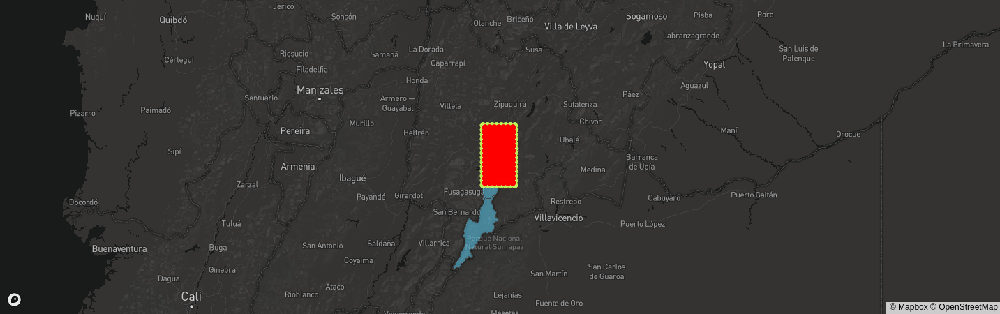

In [8]:
# to compare prediction with need use the original mesh from open cp
# we get the mesh original points and centroids for time series forecasting
mesh_points_4000, centroids_points_4000 = tools.grid_forecast_opencp(mesh_open_cp=mesh_open_cp_4000, 
                                                     bandwidth=4000, c_points=True, 
                                                           figure=True)

In [9]:
# obtain the centroids of the incidents in correspondence with the bandwidth
data_time_series = tools.index_centroids_incidents_by_mesh(data=data_time_series, 
                                                    mesh=mesh_open_cp_4000, bandwidth=4000)

In [10]:
# obtain data to forecast by centroids
time_series_data_forecast_4000 = st.time_series_full_city(data=data_time_series, 
                                                     t_serie='daily', 
                                                     start_date='2014-01-01', 
                                                     end_date='2019-11-24', 
                                                     bandwidth=4000)

In [11]:
# forecasting with time series to full city
matrix_fcast_4000, matrix_obser_4000 = forecast.next_day_continous_forecast(x_points=centroids_points_4000[0], 
                                                                  y_points=centroids_points_4000[1],
                                                                  sdt=start_date_training,
                                                                  edt=end_date_training,
                                                                  data=time_series_data_forecast_4000)

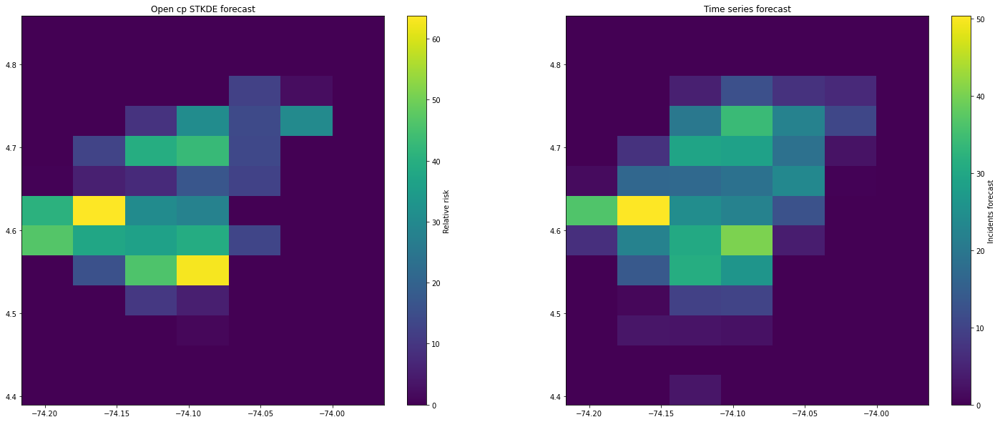

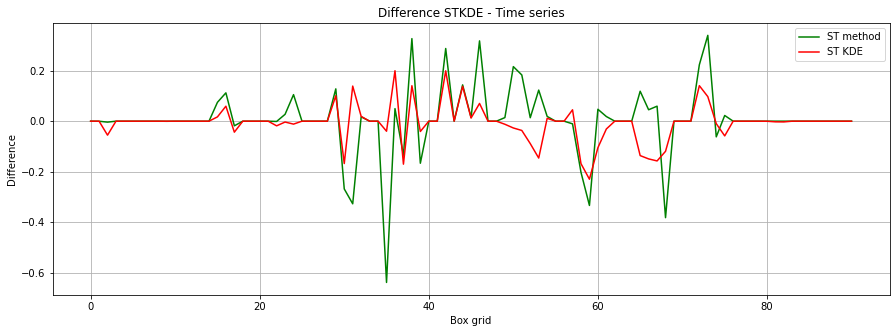

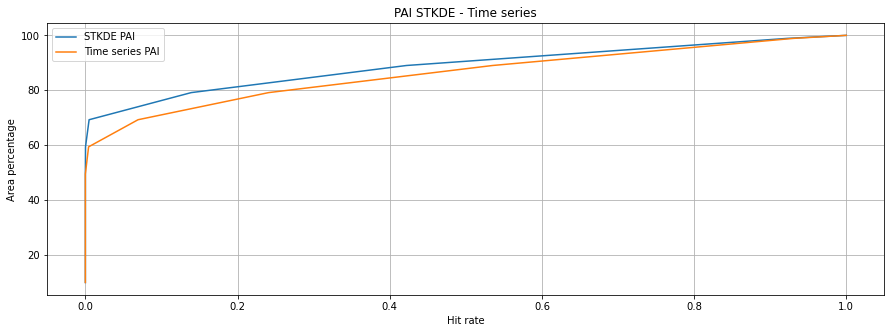

RMSE_STKDE-4000: 0.131674  RMSE_TS-4000: 0.071208 


In [12]:
forecast_statistics.results_forecast_comparison(mesh_data=mesh_points_4000, 
                            fcast_stkde=STKDE_4000['matrix_intensity'], 
                            fcast_tseries=matrix_fcast_4000, 
                            obs=matrix_obser_4000, bandwidth=4000)

#### 3.2. Forecast with time series 2000 mts

In [13]:
# configuring the original tuple with coordinates for generate a centroids for prediction
mesh_open_cp_2000 = (np.array(STKDE_2000['lats']), np.array(STKDE_2000['lons']))

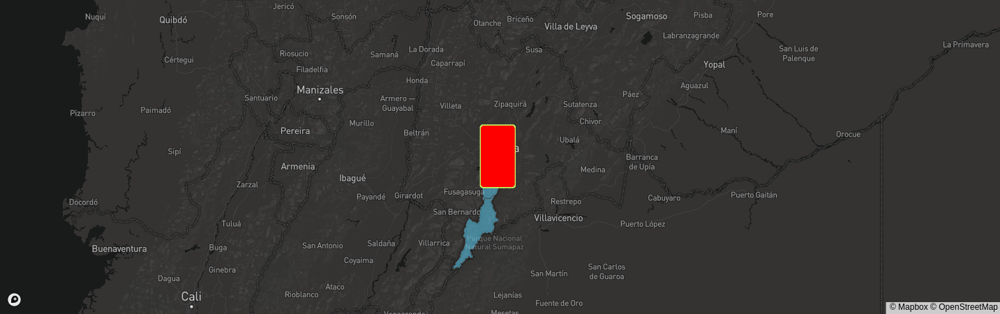

In [14]:
# to compare prediction with need use the original mesh from open cp
# we get the mesh original points and centroids for time series forecasting
mesh_points_2000, centroids_points_2000 = tools.grid_forecast_opencp(mesh_open_cp=mesh_open_cp_2000, 
                                                     bandwidth=2000, c_points=True, 
                                                           figure=True)

In [15]:
# obtain the centroids of the incidents in correspondence with the bandwidth
data_time_series = tools.index_centroids_incidents_by_mesh(data=data_time_series, 
                                                    mesh=mesh_open_cp_2000, bandwidth=2000)

In [16]:
# obtain data to forecast by centroids
time_series_data_forecast_2000 = st.time_series_full_city(data=data_time_series, 
                                                     t_serie='daily', 
                                                     start_date='2014-01-01', 
                                                     end_date='2019-11-24', 
                                                     bandwidth=2000)

In [17]:
# forecasting with time series to full city
matrix_fcast_2000, matrix_obser_2000 = forecast.next_day_continous_forecast(x_points=centroids_points_2000[0], 
                                                                  y_points=centroids_points_2000[1],
                                                                  sdt=start_date_training,
                                                                  edt=end_date_training,
                                                                  data=time_series_data_forecast_2000)

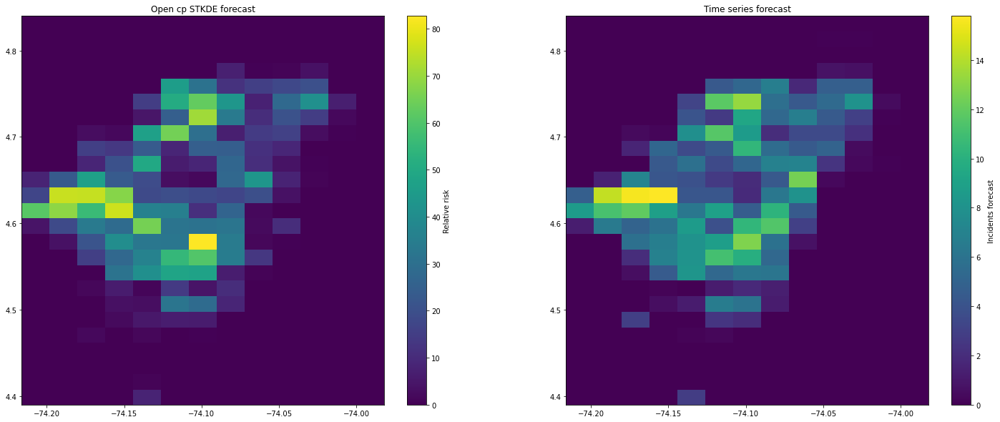

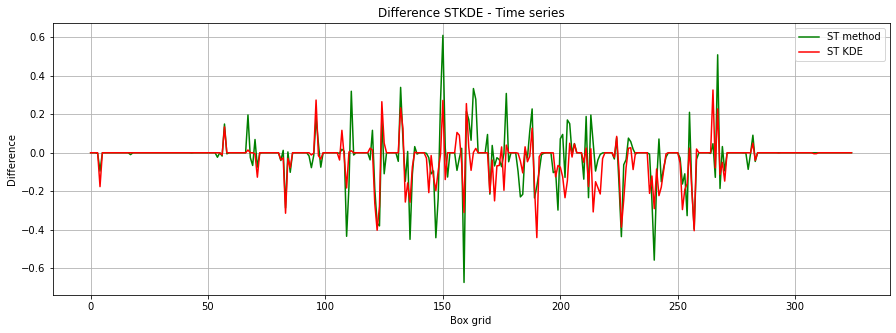

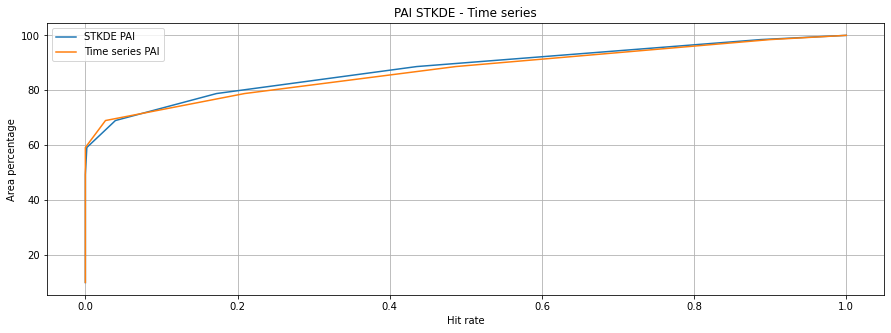

RMSE_STKDE-2000: 0.123208  RMSE_TS-2000: 0.097938 


In [18]:
forecast_statistics.results_forecast_comparison(mesh_data=mesh_points_2000, 
                            fcast_stkde=STKDE_2000['matrix_intensity'], 
                            fcast_tseries=matrix_fcast_2000, 
                            obs=matrix_obser_2000, bandwidth=2000)

#### 3.3. Forecast with time series 1000 mts

In [19]:
# configuring the original tuple with coordinates for generate a centroids for prediction
mesh_open_cp_1000 = (np.array(STKDE_1000['lats']), np.array(STKDE_1000['lons']))

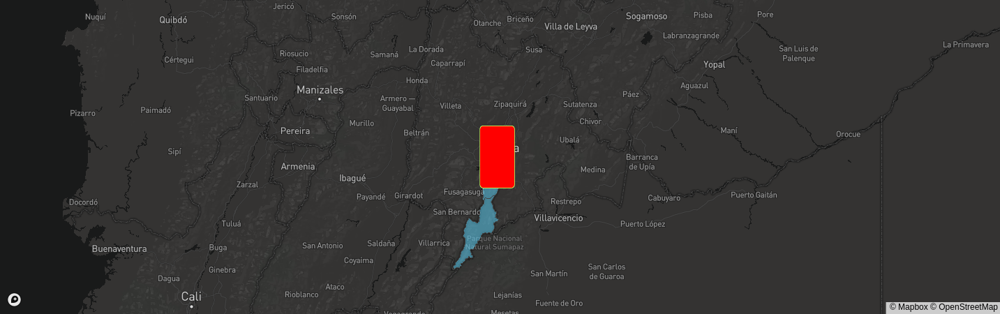

In [20]:
# to compare prediction with need use the original mesh from open cp
# we get the mesh original points and centroids for time series forecasting
mesh_points_1000, centroids_points_1000 = tools.grid_forecast_opencp(mesh_open_cp=mesh_open_cp_1000, 
                                                     bandwidth=1000, c_points=True, 
                                                           figure=True)

In [21]:
# obtain the centroids of the incidents in correspondence with the bandwidth
data_time_series = tools.index_centroids_incidents_by_mesh(data=data_time_series, 
                                                    mesh=mesh_open_cp_1000, bandwidth=1000)

In [22]:
# obtain data to forecast by centroids
time_series_data_forecast_1000 = st.time_series_full_city(data=data_time_series, 
                                                     t_serie='daily', 
                                                     start_date='2014-01-01', 
                                                     end_date='2019-11-24', 
                                                     bandwidth=1000)

In [23]:
# forecasting with time series to full city
matrix_fcast_1000, matrix_obser_1000 = forecast.next_day_continous_forecast(x_points=centroids_points_1000[0], 
                                                                  y_points=centroids_points_1000[1],
                                                                  sdt=start_date_training,
                                                                  edt=end_date_training,
                                                                  data=time_series_data_forecast_1000)

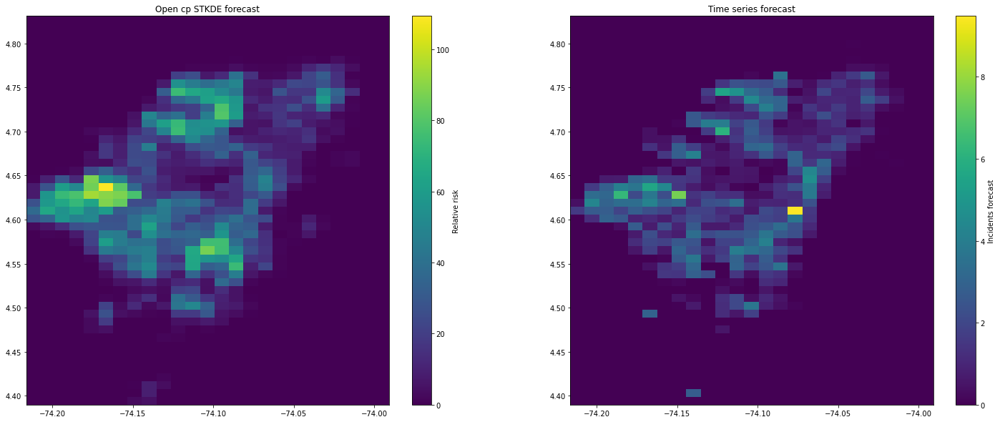

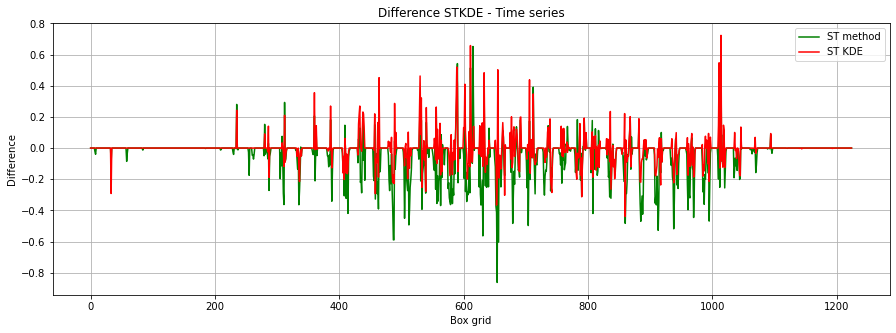

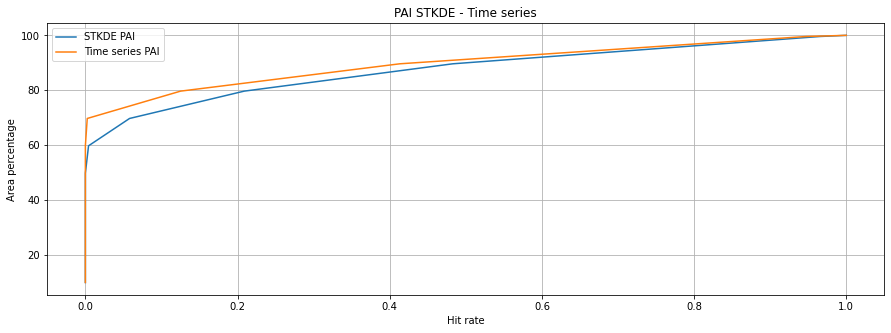

RMSE_STKDE-1000: 0.126574  RMSE_TS-1000: 0.085130 


In [24]:
forecast_statistics.results_forecast_comparison(mesh_data=mesh_points_1000, 
                            fcast_stkde=STKDE_1000['matrix_intensity'], 
                            fcast_tseries=matrix_fcast_1000, 
                            obs=matrix_obser_1000, bandwidth=1000)

#### 3.4. Forecast with time series 500 mts

In [25]:
# configuring the original tuple with coordinates for generate a centroids for prediction
mesh_open_cp_500 = (np.array(STKDE_5OO['lats']), np.array(STKDE_5OO['lons']))

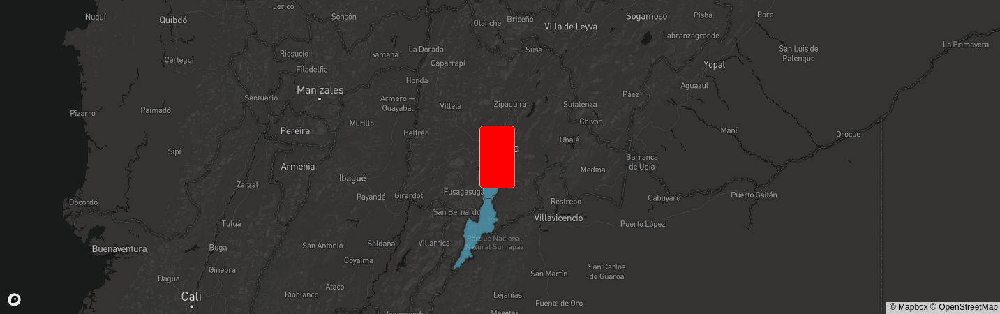

In [26]:
# to compare prediction with need use the original mesh from open cp
# we get the mesh original points and centroids for time series forecasting
mesh_points_500, centroids_points_500 = tools.grid_forecast_opencp(mesh_open_cp=mesh_open_cp_500, 
                                                     bandwidth=500, c_points=True, 
                                                           figure=True)

In [27]:
# obtain the centroids of the incidents in correspondence with the bandwidth
data_time_series = tools.index_centroids_incidents_by_mesh(data=data_time_series, 
                                                    mesh=mesh_open_cp_500, bandwidth=500)

In [28]:
# obtain data to forecast by centroids
time_series_data_forecast_500 = st.time_series_full_city(data=data_time_series, 
                                                     t_serie='daily', 
                                                     start_date='2014-01-01', 
                                                     end_date='2019-11-24', 
                                                     bandwidth=500)

In [29]:
# forecasting with time series to full city
matrix_fcast_500, matrix_obser_500 = forecast.next_day_continous_forecast(x_points=centroids_points_500[0], 
                                                                  y_points=centroids_points_500[1],
                                                                  sdt=start_date_training,
                                                                  edt=end_date_training,
                                                                  data=time_series_data_forecast_500)

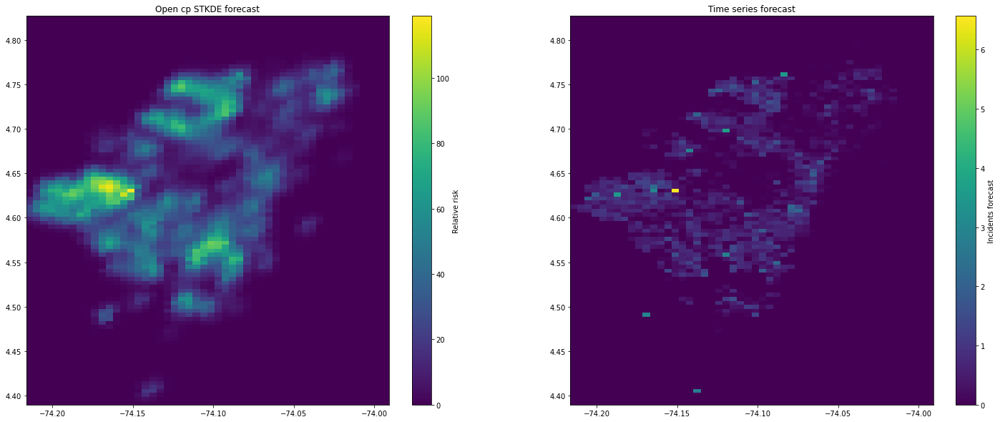

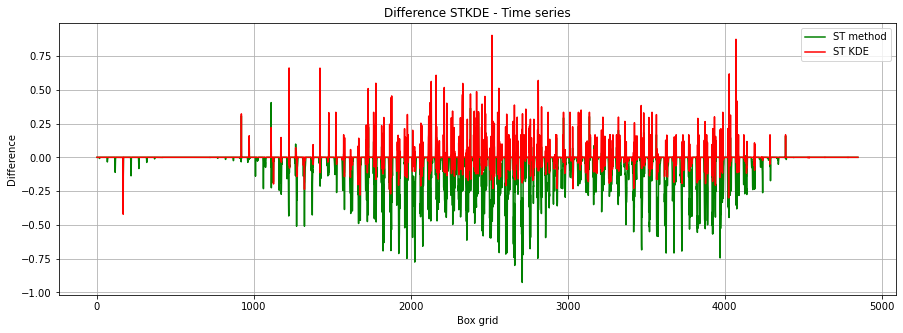

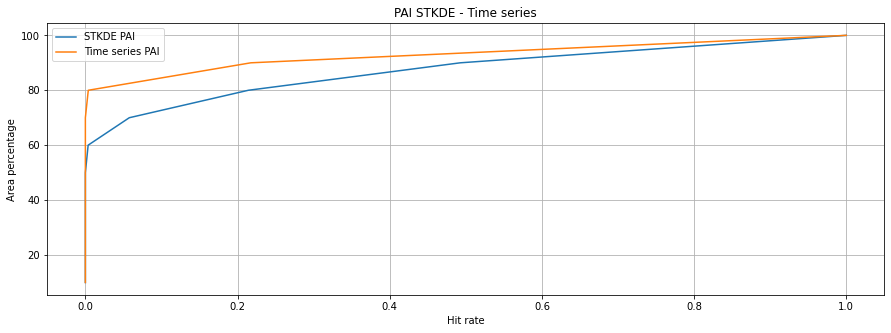

RMSE_STKDE-500: 0.150596  RMSE_TS-500: 0.069182 


In [30]:
forecast_statistics.results_forecast_comparison(mesh_data=mesh_points_500, 
                            fcast_stkde=STKDE_5OO['matrix_intensity'], 
                            fcast_tseries=matrix_fcast_500, 
                            obs=matrix_obser_500, bandwidth=500)